<a href="https://colab.research.google.com/github/claudio1975/Climate_Risk_Modelling_with_LLMs/blob/main/single_step/Flood_pred_whole_deaths_work_single_step_aug_v_1_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Prepare Workspace

In [ ]:
! pip install shap &> /dev/null

In [ ]:
! pip install optuna &> /dev/null

In [ ]:
# utils packages
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
import seaborn as sns
import datetime
import scipy
import scipy.stats as stats
import statsmodels
import sklearn
import lightgbm
from pandas.plotting import autocorrelation_plot
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
from math import radians, sin, cos, sqrt, atan2
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from scipy.stats import randint
import optuna


# packages for prediction and other utils functions
from sklearn.linear_model import TweedieRegressor
from sklearn.ensemble import IsolationForest
from lightgbm import LGBMRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, TimeSeriesSplit
from sklearn.preprocessing import MinMaxScaler

# to evaluate models
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_poisson_deviance
from sklearn.metrics import make_scorer
import shap

import warnings
warnings.simplefilter(action='ignore', category=UserWarning)
warnings.simplefilter(action='ignore', category=FutureWarning)

In [ ]:
np.__version__

'1.25.2'

In [ ]:
pd.__version__

'2.0.3'

In [ ]:
matplotlib.__version__

'3.7.1'

In [ ]:
sns.__version__

'0.13.1'

In [ ]:
scipy.__version__

'1.11.4'

In [ ]:
statsmodels.__version__

'0.14.2'

In [ ]:
sklearn.__version__

'1.2.2'

In [ ]:
optuna.__version__

'3.6.1'

In [ ]:
shap.__version__

'0.45.1'

In [ ]:
lightgbm.__version__

'4.1.0'

### Upload data set

In [ ]:
df=pd.read_csv('./flood_dataset_fe4.csv',index_col=0)

### Handling Date Time format

In [ ]:
# Trasform BEGIN_DATE_TIME and END_DATE_TIME in datetime format
df["BEGIN_DATE_TIME"] = pd.to_datetime(df["BEGIN_DATE_TIME"], format="%d-%b-%y %H:%M:%S")
df["END_DATE_TIME"] = pd.to_datetime(df["END_DATE_TIME"], format="%d-%b-%y %H:%M:%S")

In [ ]:
# Create index
df.index = pd.to_datetime(df.BEGIN_DATE_TIME)
df.index.names = ['Date']
# Sort DataFrame by date column in descending order
df.sort_values(by='Date', ascending = True, inplace = True)
# Sanity check: data span.
df.index.min(), df.index.max()

(Timestamp('2006-10-02 14:00:00'), Timestamp('2022-12-31 23:00:00'))

### Have a brief look of the data set

In [ ]:
df.shape

(38398, 53)

In [ ]:
df.columns

Index(['EVENT_ID', 'BEGIN_DATE_TIME', 'END_DATE_TIME', 'STATE', 'STATE_FIPS',
       'EVENT_TYPE', 'CZ_TYPE', 'CZ_FIPS', 'CZ_NAME', 'WFO', 'CZ_TIMEZONE',
       'INJURIES_DIRECT', 'INJURIES_INDIRECT', 'DEATHS_DIRECT',
       'DEATHS_INDIRECT', 'DAMAGE_PROPERTY', 'DAMAGE_CROPS', 'SOURCE',
       'FLOOD_CAUSE', 'BEGIN_RANGE', 'BEGIN_AZIMUTH', 'BEGIN_LOCATION',
       'END_RANGE', 'END_AZIMUTH', 'END_LOCATION', 'BEGIN_LAT', 'BEGIN_LON',
       'END_LAT', 'END_LON', 'EPISODE_NARRATIVE', 'EVENT_NARRATIVE',
       'predicted_sentiment_gpt', 'embed_episod_gpt0', 'embed_episod_gpt1',
       'embed_episod_gpt2', 'embed_episod_gpt3', 'embed_episod_gpt4',
       'embed_episod_gpt5', 'embed_episod_gpt6', 'embed_episod_gpt7',
       'embed_episod_gpt8', 'embed_episod_gpt9', 'embed_event_gpt0',
       'embed_event_gpt1', 'embed_event_gpt2', 'embed_event_gpt3',
       'embed_event_gpt4', 'embed_event_gpt5', 'embed_event_gpt6',
       'embed_event_gpt7', 'embed_event_gpt8', 'embed_event_gpt9',
       

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 38398 entries, 2006-10-02 14:00:00 to 2022-12-31 23:00:00
Data columns (total 53 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   EVENT_ID                 38398 non-null  int64         
 1   BEGIN_DATE_TIME          38398 non-null  datetime64[ns]
 2   END_DATE_TIME            38398 non-null  datetime64[ns]
 3   STATE                    38398 non-null  object        
 4   STATE_FIPS               38398 non-null  float64       
 5   EVENT_TYPE               38398 non-null  object        
 6   CZ_TYPE                  38398 non-null  object        
 7   CZ_FIPS                  38398 non-null  int64         
 8   CZ_NAME                  38398 non-null  object        
 9   WFO                      38398 non-null  object        
 10  CZ_TIMEZONE              38398 non-null  object        
 11  INJURIES_DIRECT          38398 non-null  int64         
 1

In [ ]:
num_cols = [var for var in df.columns if df[var].dtype in ['int64','float64']]
num = df[num_cols]
num.columns

Index(['EVENT_ID', 'STATE_FIPS', 'CZ_FIPS', 'INJURIES_DIRECT',
       'INJURIES_INDIRECT', 'DEATHS_DIRECT', 'DEATHS_INDIRECT',
       'DAMAGE_PROPERTY', 'DAMAGE_CROPS', 'BEGIN_RANGE', 'END_RANGE',
       'BEGIN_LAT', 'BEGIN_LON', 'END_LAT', 'END_LON', 'embed_episod_gpt0',
       'embed_episod_gpt1', 'embed_episod_gpt2', 'embed_episod_gpt3',
       'embed_episod_gpt4', 'embed_episod_gpt5', 'embed_episod_gpt6',
       'embed_episod_gpt7', 'embed_episod_gpt8', 'embed_episod_gpt9',
       'embed_event_gpt0', 'embed_event_gpt1', 'embed_event_gpt2',
       'embed_event_gpt3', 'embed_event_gpt4', 'embed_event_gpt5',
       'embed_event_gpt6', 'embed_event_gpt7', 'embed_event_gpt8',
       'embed_event_gpt9'],
      dtype='object')

In [ ]:
obj_cols = [var for var in df.columns if df[var].dtype in ['object']]
cat = df[obj_cols]
cat.columns

Index(['STATE', 'EVENT_TYPE', 'CZ_TYPE', 'CZ_NAME', 'WFO', 'CZ_TIMEZONE',
       'SOURCE', 'FLOOD_CAUSE', 'BEGIN_AZIMUTH', 'BEGIN_LOCATION',
       'END_AZIMUTH', 'END_LOCATION', 'EPISODE_NARRATIVE', 'EVENT_NARRATIVE',
       'predicted_sentiment_gpt', 'predicted_risk_gpt'],
      dtype='object')

### Build features

In [ ]:
# Created year, month, day, time begin/end feature
df_1 = df.copy()
df_1['YEAR_BEGIN'] = pd.DatetimeIndex(df_1['BEGIN_DATE_TIME']).year
df_1['MONTH_BEGIN'] = pd.DatetimeIndex(df_1['BEGIN_DATE_TIME']).month
df_1['DAY_BEGIN'] = pd.DatetimeIndex(df_1['BEGIN_DATE_TIME']).day
df_1['HOUR_BEGIN'] = pd.DatetimeIndex(df_1['BEGIN_DATE_TIME']).hour
df_1['YEAR_BEGIN']= df_1["YEAR_BEGIN"].astype("int64")
df_1['MONTH_BEGIN']= df_1["MONTH_BEGIN"].astype("int64")
df_1['DAY_BEGIN']= df_1["DAY_BEGIN"].astype("int64")
df_1['HOUR_BEGIN']= df_1["HOUR_BEGIN"].astype("int64")
df_1['YEAR_END'] = pd.DatetimeIndex(df_1['END_DATE_TIME']).year
df_1['MONTH_END'] = pd.DatetimeIndex(df_1['END_DATE_TIME']).month
df_1['DAY_END'] = pd.DatetimeIndex(df_1['END_DATE_TIME']).day
df_1['HOUR_END'] = pd.DatetimeIndex(df_1['END_DATE_TIME']).hour
df_1['YEAR_END']= df_1["YEAR_END"].astype("int64")
df_1['MONTH_END']= df_1["MONTH_END"].astype("int64")
df_1['DAY_END']= df_1["DAY_END"].astype("int64")
df_1['HOUR_END']= df_1["HOUR_END"].astype("int64")

In [ ]:
# Calculate the difference between dates and convert it to days and hours
df_1['DAY_DURATION'] = (df_1['END_DATE_TIME'] - df_1['BEGIN_DATE_TIME']).dt.days
df_1['HOUR_DURATION'] = (df_1['END_DATE_TIME'] - df_1['BEGIN_DATE_TIME']).dt.total_seconds() / 3600

In [ ]:
# Merge Origin and Destination to have a look at the round event
df_1['LOCATION_ORIGIN_DESTINATION'] = df_1['BEGIN_LOCATION']+'-'+df_1['END_LOCATION']
df_1['BEGIN_END_AZIMUTH'] = df_1['BEGIN_AZIMUTH']+'-'+df_1['END_AZIMUTH']

In [ ]:
# new target features
df_1['WHOLE_INJURIES'] = df_1['INJURIES_INDIRECT'] + df_1['INJURIES_DIRECT']
df_1['WHOLE_DEATHS'] = df_1['DEATHS_INDIRECT'] + df_1['DEATHS_DIRECT']
df_1['WHOLE_DAMAGE'] = df_1['DAMAGE_CROPS'] + df_1['DAMAGE_PROPERTY']

In [ ]:
# Distance of the event
def haversine_distance(row):
    # Convert latitude and longitude from degrees to radians
    lat1, lon1 = radians(row['BEGIN_LAT']), radians(row['BEGIN_LON'])
    lat2, lon2 = radians(row['END_LAT']), radians(row['END_LON'])

    # Haversine formula
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * atan2(sqrt(a), sqrt(1-a))
    radius_of_earth = 6371  # Earth's radius in kilometers
    distance = radius_of_earth * c

    return distance

In [ ]:
# Distance
df_1['DISTANCE'] = df_1.apply(haversine_distance, axis=1)
df_1['DISTANCE_RANGE']=df_1['END_RANGE']-df_1['BEGIN_RANGE']

In [ ]:
# Drop old variables replaced by new variables
df_2=df_1.copy()
df_2 = df_2.drop(['BEGIN_LOCATION','END_LOCATION','BEGIN_AZIMUTH','END_AZIMUTH',
                  'INJURIES_INDIRECT','DEATHS_INDIRECT','DAMAGE_CROPS',
                  'END_RANGE','BEGIN_RANGE','BEGIN_LAT','BEGIN_LON','END_LAT','END_LON'], axis=1)

### Encoding

In [ ]:
df_encod=df_2.copy()

In [ ]:
# encod_predicted_sentiment_gpt
encod_sentiment = {'negative':'0','positive':'1','neutral':'2'}
df_encod['predicted_sentiment_gpt'] = df_encod['predicted_sentiment_gpt'].map(encod_sentiment)
df_encod['predicted_sentiment_gpt']= df_encod['predicted_sentiment_gpt'].astype(int)
# encod_predicted_risk_gpt
encod_risk = {'high risk':'0','medium risk':'1','low risk':'2'}
df_encod['predicted_risk_gpt'] = df_encod['predicted_risk_gpt'].map(encod_risk)
df_encod['predicted_risk_gpt']= df_encod['predicted_risk_gpt'].astype(int)


In [ ]:
# grouping_STATE
# '0' -> 'OTHERS'
state_group = {'CALIFORNIA':'1','ILLINOIS':'2','INDIANA':'3','KENTUCKY':'4','ARKANSAS':'5','TEXAS':'6','MASSACHUSETTS':'7','MISSOURI':'8'}
df_encod['STATE'] = df_encod['STATE'].map(state_group)
df_encod['STATE'].fillna('0', inplace=True)
df_encod['STATE']= df_encod['STATE'].astype(int)


In [ ]:
# grouping_CZ_NAME
# '0' -> 'OTHERS'
state_group = {'RIVERSIDE':'1','JACKSON':'2','CALLOWAY':'3','IMPERIAL':'4','LA SALLE':'5'}
df_encod['CZ_NAME'] = df_encod['CZ_NAME'].map(state_group)
df_encod['CZ_NAME'].fillna('0', inplace=True)
df_encod['CZ_NAME']= df_encod['CZ_NAME'].astype(int)


In [ ]:
# grouping_WFO
# '0' -> 'OTHERS'
state_group = {'SGX':'1','PAH':'2','LZK':'3','BOX':'4','LOT':'5','IND':'6','PSR':'7','FWD':'8'}
df_encod['WFO'] = df_encod['WFO'].map(state_group)
df_encod['WFO'].fillna('0', inplace=True)
df_encod['WFO']= df_encod['WFO'].astype(int)


In [ ]:
# grouping_CZ_TIMEZONE
# '0' -> 'OTHERS'
state_group = {'CST-6':'1','PST-8':'2','MST-7':'3','EST-5':'4'}
df_encod['CZ_TIMEZONE'] = df_encod['CZ_TIMEZONE'].map(state_group)
df_encod['CZ_TIMEZONE'].fillna('0', inplace=True)
df_encod['CZ_TIMEZONE']= df_encod['CZ_TIMEZONE'].astype(int)

In [ ]:
# grouping_SOURCE
# '0' -> 'OTHERS'
state_group = {'Law Enforcement':'1','Newspaper':'2','Broadcast Media':'3','Emergency Manager':'4','Other Federal Agency':'5','Amateur Radio':'6','River/Stream Gage':'7','Trained Spotter':'8'}
df_encod['SOURCE'] = df_encod['SOURCE'].map(state_group)
df_encod['SOURCE'].fillna('0', inplace=True)
df_encod['SOURCE']= df_encod['SOURCE'].astype(int)

In [ ]:
# grouping_FLOOD_CAUSE
# '0' -> 'OTHERS'
state_group = {'Heavy Rain':'1','Heavy Rain/Snow Melt':'2'}
df_encod['FLOOD_CAUSE'] = df_encod['FLOOD_CAUSE'].map(state_group)
df_encod['FLOOD_CAUSE'].fillna('0', inplace=True)
df_encod['FLOOD_CAUSE']= df_encod['FLOOD_CAUSE'].astype(int)

In [ ]:
# grouping_BEGIN_END_AZIMUTH
# '0' -> 'OTHERS'
state_group = {'NNE-S':'1','N-N':'2','SE-NW':'3','ENE-ESE':'4','NNW-SW':'5'}
df_encod['BEGIN_END_AZIMUTH'] = df_encod['BEGIN_END_AZIMUTH'].map(state_group)
df_encod['BEGIN_END_AZIMUTH'].fillna('0', inplace=True)
df_encod['BEGIN_END_AZIMUTH']= df_encod['BEGIN_END_AZIMUTH'].astype(int)

In [ ]:
# grouping_LOCATION_ORIGIN_DESTINATION
# '0' -> 'OTHERS'
state_group = {'MURRIETTA ARPT-WINCHESTER':'1','ROCKFORD-FREEMAN ARPT':'2','LAKE HOLIDAY-RANSOM':'3','DIXIELAND-DIXIELAND':'4'}
df_encod['LOCATION_ORIGIN_DESTINATION'] = df_encod['LOCATION_ORIGIN_DESTINATION'].map(state_group)
df_encod['LOCATION_ORIGIN_DESTINATION'].fillna('0', inplace=True)
df_encod['LOCATION_ORIGIN_DESTINATION']= df_encod['LOCATION_ORIGIN_DESTINATION'].astype(int)

### Remove Outliers

In [ ]:
df_3=df_encod.copy()

#### Fine-Tuning Isolation Forest

In [ ]:
# Create a custom scorer object
#poisson_scorer = make_scorer(mean_poisson_deviance, greater_is_better=False)

#param_grid = {
#    "contamination": [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5],
#}

#iso_forest = IsolationForest(random_state=0)
#iso_forest_model = GridSearchCV(iso_forest, param_grid, cv=5, scoring=poisson_scorer)
#iso_forest_model.fit(df_3[['INJURIES_DIRECT','DEATHS_DIRECT','DAMAGE_PROPERTY',
#                     'WHOLE_INJURIES','WHOLE_DEATHS','WHOLE_DAMAGE']])

#print("Best parameters:", iso_forest_model.best_params_)

#### Fit the model

In [ ]:
def is_outlier(x):
    return 'yes' if x == -1 else 'no'

model = IsolationForest(contamination=0.01, random_state=0)
predictions = model.fit_predict(df_3[['INJURIES_DIRECT','DEATHS_DIRECT','DAMAGE_PROPERTY',
                     'WHOLE_INJURIES','WHOLE_DEATHS','WHOLE_DAMAGE']])
outliers = np.vectorize(is_outlier)(predictions)
outliers_series = pd.DataFrame(outliers, columns=['outliers'], index=df_3.index)
df_3_ = pd.concat([df_3, outliers_series], axis=1)

In [ ]:
df_3_.query('outliers=="yes"').shape

(384, 58)

In [ ]:
df_4 = df_3_.query('outliers=="no"')
df_4.shape

(38014, 58)

In [ ]:
# drop not useful features and targets not used
df_5=df_4.drop(['EVENT_ID','BEGIN_DATE_TIME','END_DATE_TIME','EPISODE_NARRATIVE',
                     'EVENT_NARRATIVE','EVENT_TYPE','CZ_TYPE','outliers','INJURIES_DIRECT','DAMAGE_PROPERTY',
                     'WHOLE_INJURIES','DEATHS_DIRECT','WHOLE_DAMAGE'], axis=1)


In [ ]:
target = df_5[['WHOLE_DEATHS']]
X_all = df_5.drop(['WHOLE_DEATHS'], axis=1)
X_all.shape

(38014, 44)

### Zero Variance Predictors

In [ ]:
# Find features with variance equal zero or lower than 0.05
to_drop = [col for col in X_all.columns if np.var(X_all[col]) ==0]
to_drop

[]

In [ ]:
# Drop features
X_all_v = X_all.drop(X_all[to_drop], axis=1)

### Correlated Predictors

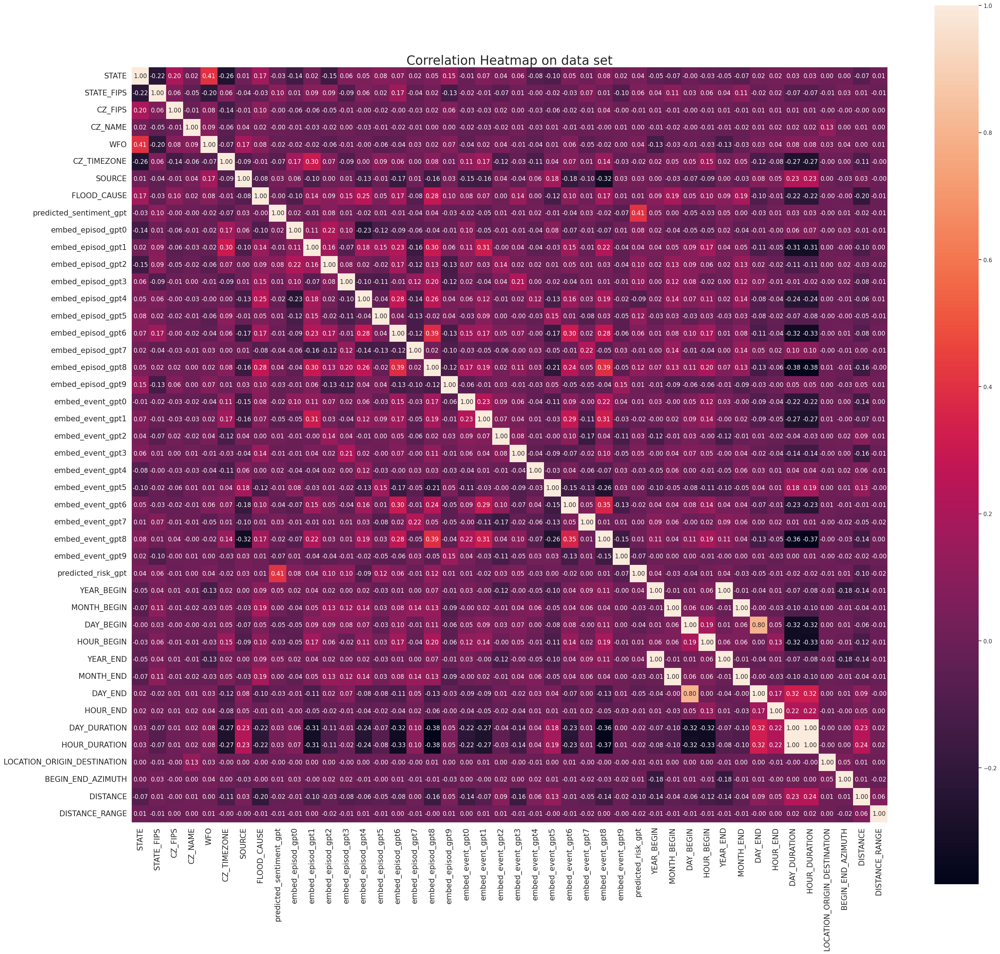

In [ ]:
# Correlation heatmap
corr_matrix = X_all.corr()
sns.set( rc = {'figure.figsize': (30, 30)})
plt.figure()
sns.heatmap(corr_matrix, square = True, annot=True, fmt='.2f')
plt.title('Correlation Heatmap on data set',size=25)
plt.yticks(fontsize="15")
plt.xticks(fontsize="15")
plt.show()

In [ ]:
# Select correlated features and removed it
# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
# Find index of feature columns with correlation greater than 0.75
to_drop = [column for column in upper.columns if any(upper[column].abs() > 0.75)]
to_drop

['YEAR_END', 'MONTH_END', 'DAY_END', 'HOUR_DURATION']

In [ ]:
# Drop features
X_all_f = X_all.drop(X_all[to_drop], axis=1)

In [ ]:
# Look at the new features data set
X_all_f.shape

(38014, 40)

### Standardization

In [ ]:
scaling=MinMaxScaler()

In [ ]:
num1_ = ['STATE_FIPS',
'CZ_FIPS',
'YEAR_BEGIN',
'MONTH_BEGIN',
'DAY_BEGIN',
'HOUR_BEGIN',
'HOUR_END',
'DAY_DURATION',
'DISTANCE',
'DISTANCE_RANGE']

In [ ]:
num2_=['embed_episod_gpt0',
'embed_episod_gpt1',
'embed_episod_gpt2',
'embed_episod_gpt3',
'embed_episod_gpt4',
'embed_episod_gpt5',
'embed_episod_gpt6',
'embed_episod_gpt7',
'embed_episod_gpt8',
'embed_episod_gpt9',
'embed_event_gpt0',
'embed_event_gpt1',
'embed_event_gpt2',
'embed_event_gpt3',
'embed_event_gpt4',
'embed_event_gpt5',
'embed_event_gpt6',
'embed_event_gpt7',
'embed_event_gpt8',
'embed_event_gpt9']

In [ ]:
cat_=['STATE',
'CZ_NAME',
'WFO',
'CZ_TIMEZONE',
'SOURCE',
'FLOOD_CAUSE',
'BEGIN_END_AZIMUTH',
'LOCATION_ORIGIN_DESTINATION',
'predicted_sentiment_gpt',
'predicted_risk_gpt']

In [ ]:
cat_new=X_all_f[cat_]
num1_new=X_all_f[num1_]
num2_new=X_all_f[num2_]

In [ ]:
# Features to scale
num_sc=pd.DataFrame(scaling.fit_transform(num1_new),
columns = ['STATE_FIPS',
'CZ_FIPS',
'YEAR_BEGIN',
'MONTH_BEGIN',
'DAY_BEGIN',
'HOUR_BEGIN',
'HOUR_END',
'DAY_DURATION',
'DISTANCE',
'DISTANCE_RANGE'], index=cat_new.index)

In [ ]:
# New features scaled data set
X_all_sc = pd.concat([cat_new, num_sc, num2_new],axis='columns')

### Feature Engineering with Lag and Rolling Window Features

In [ ]:
# Lag Features function
def lag_feat(df, var):
  df_lag = df.copy()  # Create a copy of the original dataframe
  lags = [1,7,30,90, 180, 270, 365]  # 1 day, 7 days, 1 month, 3 months, 6 months, 9 months, 1 year
  outcomes = [var]
  df_lag=df_lag.assign(**{
      f'{col} (t-{lag})': df_lag[col].shift(lag)
      for lag in lags
      for col in outcomes})
  # Remove nan values
  df_lag = df_lag.dropna()
  return df_lag

In [ ]:
# Rolling features function
def win_feat(df_lag, var):
  windows = [7, 30]  # 7 days, 1 month
  outcomes = [var]
  df_lag_win = df_lag.copy()
  for window in windows:
    for col in outcomes:
        df_lag_win[f"{col} (r_w-{window}) mean"] = df_lag_win[col].rolling(window=window).mean()
  # Remove nan values
  df_lag_win = df_lag_win.dropna()
  return df_lag_win


In [ ]:
all = pd.concat([target, X_all_f], axis=1)
all_sc = pd.concat([target, X_all_sc], axis=1)


In [ ]:
all_lag=lag_feat(all, 'WHOLE_DEATHS')
all_lag_win=win_feat(all_lag, 'WHOLE_DEATHS')
all_lag_sc=lag_feat(all_sc, 'WHOLE_DEATHS')
all_lag_win_sc=win_feat(all_lag_sc, 'WHOLE_DEATHS')

### Split data set

In [ ]:
# Attach Target variable
# Split data set train/test set : test set is built on the last year
train = all_lag_win[all_lag_win.index < '2022-01-01']
test = all_lag_win[all_lag_win.index >= '2022-01-01']
len(train), len(test)

(35727, 1893)

In [ ]:
# Attach Target variable
# Split data set train/test set : test set is built on the last year
train_sc = all_lag_win_sc[all_lag_win_sc.index < '2022-01-01']
test_sc = all_lag_win_sc[all_lag_win_sc.index >= '2022-01-01']
len(train_sc), len(test_sc)

(35727, 1893)

In [ ]:
# split target and features
X_train = train.copy()
y_train = np.log1p(X_train.WHOLE_DEATHS)
y_train = pd.DataFrame(X_train, columns=['WHOLE_DEATHS'])
X_train.drop(['WHOLE_DEATHS'], axis=1, inplace=True)
X_test = test.copy()
y_test = np.log1p(X_test.WHOLE_DEATHS)
y_test = pd.DataFrame(X_test, columns=['WHOLE_DEATHS'])
X_test.drop(['WHOLE_DEATHS'], axis=1, inplace=True)
X_train_sc = train_sc.copy()
X_train_sc.drop(['WHOLE_DEATHS'], axis=1, inplace=True)
X_test_sc = test_sc.copy()
X_test_sc.drop(['WHOLE_DEATHS'], axis=1, inplace=True)
train_exposure = np.full(X_train.shape[0], 1)
test_exposure = np.full(X_test.shape[0], 1)
train_df = train.copy()
test_df = test.copy()




### Modelling & Evaluation

### Naive

### Fit & Prediction

In [ ]:
y_train_=y_train.copy()
y_test_=y_test.copy()
y_train_['WHOLE_DEATHS_naive'] = y_train_['WHOLE_DEATHS'].shift(1)
y_test_['WHOLE_DEATHS_naive'] = y_test_['WHOLE_DEATHS'].shift(1)
predictions_tr = y_train_.drop(columns="WHOLE_DEATHS")
predictions_te = y_test_.drop(columns="WHOLE_DEATHS")
rmse_train = np.sqrt(mean_squared_error(y_train_.iloc[1:,0], predictions_tr.iloc[1:,0]))
rmse_test = np.sqrt(mean_squared_error(y_test_.iloc[1:,0], predictions_te.iloc[1:,0]))
mae_train = mean_absolute_error(y_train_.iloc[1:,0], predictions_tr.iloc[1:,0])
mae_test = mean_absolute_error(y_test_.iloc[1:,0], predictions_te.iloc[1:,0])
#mpd_train = mean_poisson_deviance(y_train.iloc[1:,0], predictions_tr.iloc[1:,0])
#mpd_test = mean_poisson_deviance(y_test.iloc[1:,0], predictions_te.iloc[1:,0])


score_naive = []
score_dict = {
        'rmse_train': rmse_train,
        'rmse_test': rmse_test,
        'mae_train': mae_train,
        'mae_test': mae_test,
        'mpd_train': 'N/A',
        'mpd_test': 'N/A'
}

score_naive.append(score_dict)
score_naive = pd.DataFrame(score_naive, columns = ['rmse_train', 'rmse_test','mae_train','mae_test','mpd_train','mpd_test'])
predictions_tr_naive = np.expm1(predictions_tr).copy()
predictions_te_naive = np.expm1(predictions_te).copy()
train_df = pd.concat([train_df, predictions_tr_naive.set_index(train_df.index)], axis=1)
test_df = pd.concat([test_df, predictions_te_naive.set_index(test_df.index)], axis=1)

### Evaluation

In [ ]:
naive_results = {'model':['naive'],
               'rmse_train':score_naive['rmse_train'],
               'rmse_test': score_naive['rmse_test'],
              'mae_train': score_naive['mae_train'],
              'mae_test': score_naive['mae_test'],
              'mpd_train': score_naive['mpd_train'],
              'mpd_test': score_naive['mpd_test']
                 }
score_naive = pd.DataFrame(naive_results,
                         columns=['model', 'rmse_train', 'rmse_test','mae_train','mae_test','mpd_train','mpd_test'])
score_naive

,model,rmse_train,rmse_test,mae_train,mae_test,mpd_train,mpd_test
0,naive,0.146236,0.148992,0.016291,0.013742,N/A,N/A


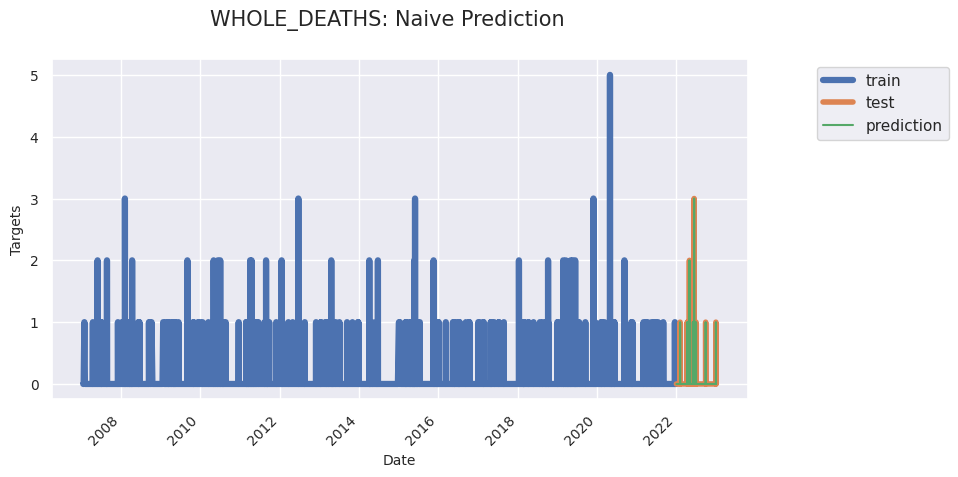

In [ ]:
fig, ax = plt.subplots(figsize=(8, 5))
y_train_['WHOLE_DEATHS'].plot(ax=ax, label='train',linewidth=4.5)
y_test_['WHOLE_DEATHS'].plot(ax=ax, label='test',linewidth=4)
y_test_['WHOLE_DEATHS_naive'].plot(ax=ax, label='prediction')
plt.suptitle('WHOLE_DEATHS: Naive Prediction', fontsize=15)
plt.xlabel('Date',fontsize=10)
plt.ylabel('Targets', fontsize=10)
plt.yticks(rotation=0,fontsize=10)
plt.xticks(rotation=45, fontsize=10)
plt.legend(fontsize=10)
ax.legend(bbox_to_anchor=(1.3, 1.0))
plt.show()

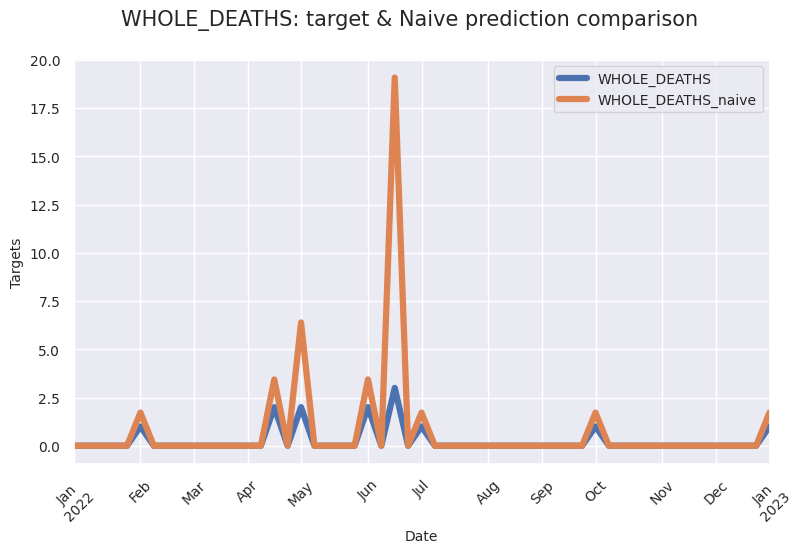

In [ ]:
# Plot results
test_df_agg = test_df.groupby(pd.Grouper(freq='W')).agg({
    'WHOLE_DEATHS': 'sum',
    'WHOLE_DEATHS_naive': 'sum'})
plt.rcParams['figure.figsize'] = (8,5)
test_df_agg.plot(linewidth=4.5)
plt.suptitle('WHOLE_DEATHS: target & Naive prediction comparison', fontsize=15)
plt.xlabel('Date',fontsize=10)
plt.ylabel('Targets', fontsize=10)
plt.yticks(rotation=0,fontsize=10)
plt.xticks(rotation=45, fontsize=10)
plt.legend(fontsize=10)
plt.show()

### GLM

#### Fine-Tuning

In [ ]:
# Fine-tuning
#def objective(trial):
#    params = {
#        'power': trial.suggest_loguniform('power', 1, 1.5),
#        'link':'log'
#    }

#    glm = TweedieRegressor(**params)

#    tscv = TimeSeriesSplit(n_splits=5)
#    mpd_scores = []

#    for train_index, val_index in tscv.split(X_train):
#        X_tr, X_val, tr_exposure = X_train.iloc[train_index], X_train.iloc[val_index], train_exposure[train_index]
#        y_tr, y_val = y_train.iloc[train_index], y_train.iloc[val_index]

#        glm.fit(X_tr, y_tr, sample_weight=tr_exposure)
#        pred_val = glm.predict(X_val)

#        mpd_score = mean_poisson_deviance(y_val, pred_val)
#        mpd_scores.append(mpd_score)

#    return np.mean(mpd_scores)

#study = optuna.create_study(direction='minimize')
#study.optimize(objective, n_trials=10)

#best_params = study.best_params


[I 2024-05-16 08:53:58,499] A new study created in memory with name: no-name-5445c27d-a93d-4d00-9a55-f3eb20a281d6
[I 2024-05-16 08:54:26,313] Trial 0 finished with value: 0.08301322188090801 and parameters: {'power': 1.2673731580838565}. Best is trial 0 with value: 0.08301322188090801.
[I 2024-05-16 08:54:53,231] Trial 1 finished with value: 0.08300519099647072 and parameters: {'power': 1.2640837313020183}. Best is trial 1 with value: 0.08300519099647072.
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_linear_loss.py:289: RuntimeWarning: invalid value encountered in matmul
  grad[:n_features] = X.T @ grad_pointwise + l2_reg_strength * weights
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_linear_loss.py:289: RuntimeWarning: invalid value encountered in matmul
  grad[:n_features] = X.T @ grad_pointwise + l2_reg_strength * weights
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_linear_loss.py:289: RuntimeWarning: invalid value encountered in mat

In [ ]:
#best_params

{'power': 1.2640837313020183}

### Fit & Prediction

In [ ]:
glm_tuned = TweedieRegressor(power=1.2640837313020183, link='log') # GLM with compound Poisson-Gamma distribution
tscv = TimeSeriesSplit(n_splits=5)
param_grid = {}
glm_model = GridSearchCV(glm_tuned,param_grid,cv=tscv)
glm_model=glm_model.fit(X_train_sc, y_train,sample_weight=train_exposure)
score_glm = []
predictions_tr = glm_model.predict(X_train_sc)
predictions_te = glm_model.predict(X_test_sc)
rmse_train = np.sqrt(mean_squared_error(y_train, predictions_tr))
rmse_test = np.sqrt(mean_squared_error(y_test, predictions_te))
mae_train = mean_absolute_error(y_train, predictions_tr)
mae_test = mean_absolute_error(y_test, predictions_te)
mpd_train = mean_poisson_deviance(y_train, predictions_tr)
mpd_test = mean_poisson_deviance(y_test, predictions_te)

score_dict = {
        'rmse_train': rmse_train,
        'rmse_test': rmse_test,
        'mae_train': mae_train,
        'mae_test': mae_test,
        'mpd_train': mpd_train,
        'mpd_test': mpd_test
    }

score_glm.append(score_dict)
score_glm = pd.DataFrame(score_glm, columns = ['rmse_train', 'rmse_test','mae_train','mae_test','mpd_train','mpd_test'])
predictions_tr_glm = pd.DataFrame(np.expm1(predictions_tr), columns = ['WHOLE_DEATHS_predict_glm'])
predictions_te_glm = pd.DataFrame(np.expm1(predictions_te), columns = ['WHOLE_DEATHS_predict_glm'])
train_df = pd.concat([train_df, predictions_tr_glm.set_index(train_df.index)], axis=1)
test_df = pd.concat([test_df, predictions_te_glm.set_index(test_df.index)], axis=1)



### Evaluation

In [ ]:
glm_results = {'model':['glm'],
               'rmse_train':score_glm['rmse_train'],
               'rmse_test': score_glm['rmse_test'],
              'mae_train': score_glm['mae_train'],
              'mae_test': score_glm['mae_test'],
               'mpd_train': score_glm['mpd_train'],
               'mpd_test': score_glm['mpd_test']
               }
score_glm = pd.DataFrame(glm_results,
                         columns=['model', 'rmse_train', 'rmse_test','mae_train','mae_test','mpd_train','mpd_test'])
score_glm

,model,rmse_train,rmse_test,mae_train,mae_test,mpd_train,mpd_test
0,glm,0.104784,0.1051,0.016771,0.015256,0.083448,0.073333


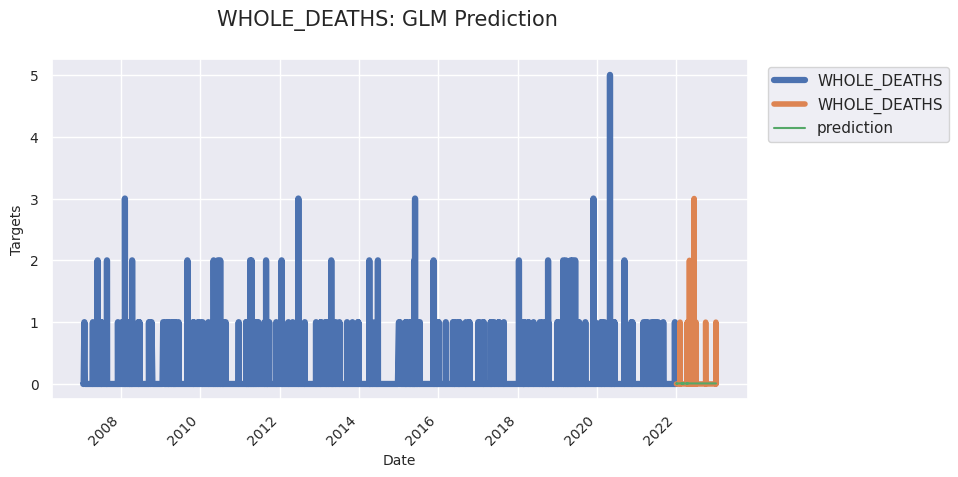

In [ ]:
fig, ax = plt.subplots(figsize=(8, 5))
y_train.plot(ax=ax, label='train',linewidth=4.5)
y_test.plot(ax=ax, label='test',linewidth=4)
test_df['WHOLE_DEATHS_predict_glm'].plot(ax=ax, label='prediction')
plt.suptitle('WHOLE_DEATHS: GLM Prediction', fontsize=15)
plt.xlabel('Date',fontsize=10)
plt.ylabel('Targets', fontsize=10)
plt.yticks(rotation=0,fontsize=10)
plt.xticks(rotation=45, fontsize=10)
plt.legend(fontsize=10)
ax.legend(bbox_to_anchor=(1.3, 1.0))
plt.show()

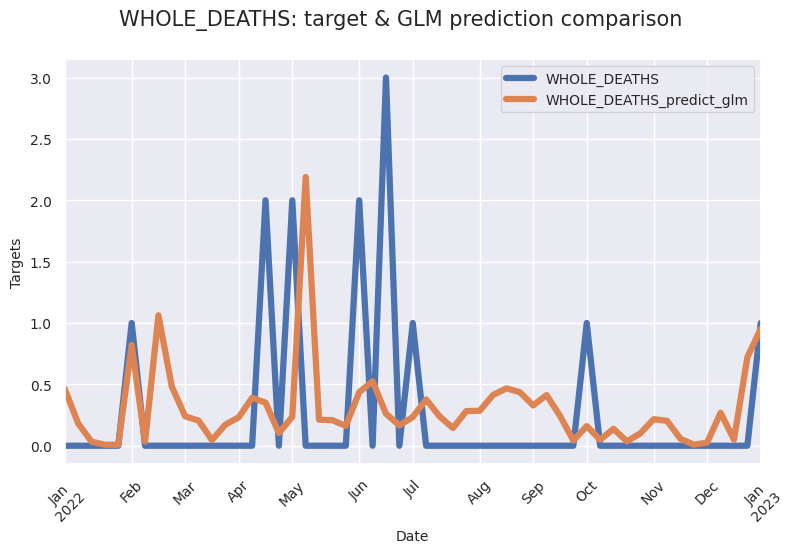

In [ ]:
# Plot results
test_df_agg = test_df.groupby(pd.Grouper(freq='W')).agg({
    'WHOLE_DEATHS': 'sum',
    'WHOLE_DEATHS_predict_glm': 'sum'})
plt.rcParams['figure.figsize'] = (8,5)
test_df_agg.plot(linewidth=4.5)
plt.suptitle('WHOLE_DEATHS: target & GLM prediction comparison', fontsize=15)
plt.xlabel('Date',fontsize=10)
plt.ylabel('Targets', fontsize=10)
plt.yticks(rotation=0,fontsize=10)
plt.xticks(rotation=45, fontsize=10)
plt.legend(fontsize=10)
plt.show()

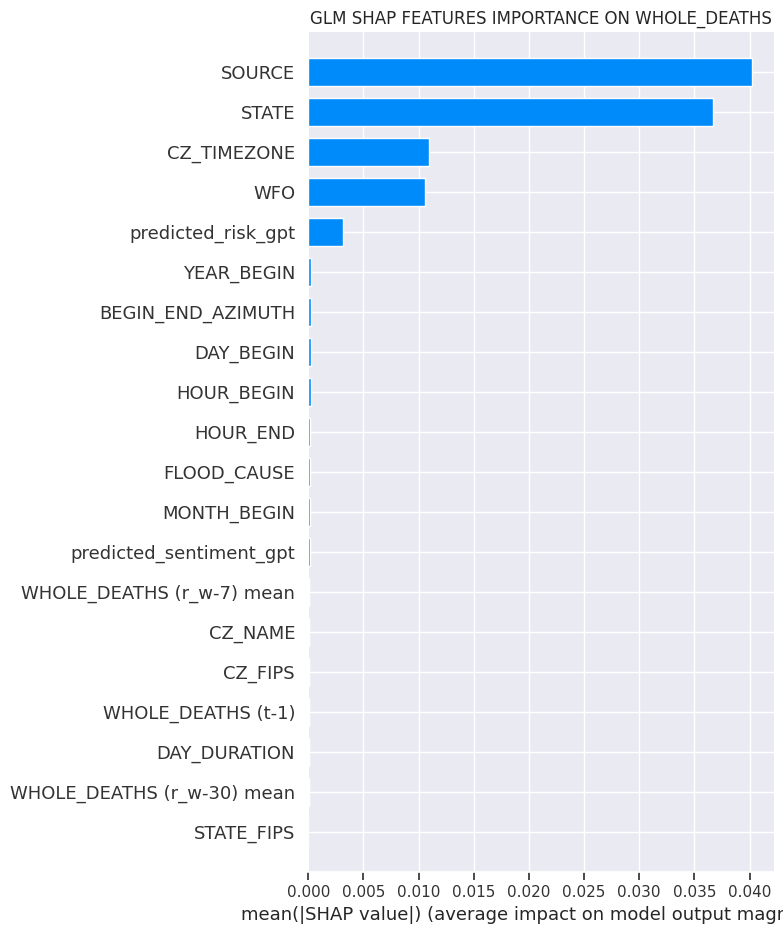

In [ ]:
# Global SHAP on GLM
GLM_ = TweedieRegressor(power=1.2640837313020183, link='log').fit(X_train_sc, y_train,sample_weight=train_exposure)
masker = shap.maskers.Independent(X_train_sc)
GLM_explainer = shap.LinearExplainer(GLM_, masker=masker)
GLM_shap_values = GLM_explainer.shap_values(X_test_sc)
plt.rcParams['figure.figsize'] = (5,5)
plt.title("GLM SHAP FEATURES IMPORTANCE ON WHOLE_DEATHS")
shap.summary_plot(GLM_shap_values, features=X_test_sc, feature_names=X_test_sc.columns,plot_type='bar')




### LightGBM

#### Fine-tuning the model

In [ ]:
# Fine-tuning

#def objective(trial):
#    params = {
#        'objective': 'poisson',
#        'random_state': 0,
#        'n_estimators': trial.suggest_int('n_estimators', 50, 1000),
#        'learning_rate': trial.suggest_loguniform('learning_rate', 0.01, 0.1),
#        'max_depth': trial.suggest_int('max_depth', 3, 8),
#        'num_leaves': trial.suggest_int('num_leaves', 20, 150),
#        'min_child_samples': trial.suggest_int('min_child_samples', 5, 100)
#    }

#    lgbm = LGBMRegressor(**params)

#    tscv = TimeSeriesSplit(n_splits=5)
#    mpd_scores = []

#    train_exposure_ = pd.DataFrame(train_exposure, index=X_train.index, columns=['exposure']) # Convert numpy array to DataFrame
#    X_train_ = pd.concat([X_train, train_exposure_], axis=1)


#    for train_index, val_index in tscv.split(X_train_):
#        X_tr, X_val = X_train_.iloc[train_index], X_train_.iloc[val_index]
#        y_tr, y_val = y_train.iloc[train_index], y_train.iloc[val_index]

#        lgbm.fit(X_tr, y_tr)
#        pred_val = lgbm.predict(X_val)

#        mpd_score = mean_poisson_deviance(y_val, pred_val)
#        mpd_scores.append(mpd_score)

#    return np.mean(mpd_scores)

#study = optuna.create_study(direction='minimize')
#study.optimize(objective, n_trials=100)

#best_params = study.best_params



[I 2024-05-16 08:59:18,225] A new study created in memory with name: no-name-60d54923-0375-4795-a953-cee700caeeb2


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 08:59:24,454] Trial 0 finished with value: 0.053789889552280104 and parameters: {'n_estimators': 688, 'learning_rate': 0.07349856735352348, 'max_depth': 6, 'num_leaves': 141, 'min_child_samples': 52}. Best is trial 0 with value: 0.053789889552280104.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000747 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 08:59:30,115] Trial 1 finished with value: 0.03674186581364815 and parameters: {'n_estimators': 588, 'learning_rate': 0.03724907616564962, 'max_depth': 7, 'num_leaves': 149, 'min_child_samples': 64}. Best is trial 1 with value: 0.03674186581364815.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001203 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5797
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 44
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 08:59:39,641] Trial 2 finished with value: 0.053979722776736586 and parameters: {'n_estimators': 842, 'learning_rate': 0.049045957948503804, 'max_depth': 8, 'num_leaves': 138, 'min_child_samples': 49}. Best is trial 1 with value: 0.03674186581364815.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001185 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5813
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 48
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 08:59:41,048] Trial 3 finished with value: 0.033303999817185466 and parameters: {'n_estimators': 156, 'learning_rate': 0.09172353126671844, 'max_depth': 6, 'num_leaves': 25, 'min_child_samples': 20}. Best is trial 3 with value: 0.033303999817185466.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001351 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5813
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 48
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 08:59:42,727] Trial 4 finished with value: 0.024646782406191843 and parameters: {'n_estimators': 205, 'learning_rate': 0.01889994502855222, 'max_depth': 6, 'num_leaves': 25, 'min_child_samples': 38}. Best is trial 4 with value: 0.024646782406191843.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 08:59:49,105] Trial 5 finished with value: 0.024055105887485217 and parameters: {'n_estimators': 925, 'learning_rate': 0.012255166101635297, 'max_depth': 5, 'num_leaves': 134, 'min_child_samples': 26}. Best is trial 5 with value: 0.024055105887485217.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 08:59:53,411] Trial 6 finished with value: 0.02581434328302255 and parameters: {'n_estimators': 689, 'learning_rate': 0.025534557249098873, 'max_depth': 4, 'num_leaves': 107, 'min_child_samples': 21}. Best is trial 5 with value: 0.024055105887485217.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 08:59:56,545] Trial 7 finished with value: 0.035645348302150916 and parameters: {'n_estimators': 695, 'learning_rate': 0.07162575493563746, 'max_depth': 3, 'num_leaves': 40, 'min_child_samples': 66}. Best is trial 5 with value: 0.024055105887485217.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 08:59:57,710] Trial 8 finished with value: 0.028275280401344048 and parameters: {'n_estimators': 129, 'learning_rate': 0.02238193641329467, 'max_depth': 7, 'num_leaves': 72, 'min_child_samples': 28}. Best is trial 5 with value: 0.024055105887485217.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Foun

[I 2024-05-16 09:00:01,211] Trial 9 finished with value: 0.02207694181324062 and parameters: {'n_estimators': 608, 'learning_rate': 0.01048120139815677, 'max_depth': 4, 'num_leaves': 77, 'min_child_samples': 55}. Best is trial 9 with value: 0.02207694181324062.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000735 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:00:03,129] Trial 10 finished with value: 0.025059106996423348 and parameters: {'n_estimators': 350, 'learning_rate': 0.011406892959215358, 'max_depth': 3, 'num_leaves': 72, 'min_child_samples': 94}. Best is trial 9 with value: 0.02207694181324062.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:00:08,801] Trial 11 finished with value: 0.024111840240417425 and parameters: {'n_estimators': 892, 'learning_rate': 0.010110046183072787, 'max_depth': 4, 'num_leaves': 114, 'min_child_samples': 9}. Best is trial 9 with value: 0.02207694181324062.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000742 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:00:11,507] Trial 12 finished with value: 0.022398419978864187 and parameters: {'n_estimators': 421, 'learning_rate': 0.015344796105979799, 'max_depth': 5, 'num_leaves': 99, 'min_child_samples': 70}. Best is trial 9 with value: 0.02207694181324062.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001045 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:00:13,861] Trial 13 finished with value: 0.02200692311548102 and parameters: {'n_estimators': 386, 'learning_rate': 0.01729248000745667, 'max_depth': 4, 'num_leaves': 99, 'min_child_samples': 81}. Best is trial 13 with value: 0.02200692311548102.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:00:16,523] Trial 14 finished with value: 0.022186383275138135 and parameters: {'n_estimators': 433, 'learning_rate': 0.015097139732816078, 'max_depth': 4, 'num_leaves': 83, 'min_child_samples': 95}. Best is trial 13 with value: 0.02200692311548102.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:00:18,702] Trial 15 finished with value: 0.023248401439861868 and parameters: {'n_estimators': 308, 'learning_rate': 0.016374230456976155, 'max_depth': 4, 'num_leaves': 62, 'min_child_samples': 82}. Best is trial 13 with value: 0.02200692311548102.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:00:21,517] Trial 16 finished with value: 0.023334791292518607 and parameters: {'n_estimators': 565, 'learning_rate': 0.030452940561516643, 'max_depth': 3, 'num_leaves': 56, 'min_child_samples': 81}. Best is trial 13 with value: 0.02200692311548102.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000790 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:00:24,621] Trial 17 finished with value: 0.022300181654988344 and parameters: {'n_estimators': 497, 'learning_rate': 0.013508119650983825, 'max_depth': 5, 'num_leaves': 90, 'min_child_samples': 81}. Best is trial 13 with value: 0.02200692311548102.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:00:26,308] Trial 18 finished with value: 0.023058450792044806 and parameters: {'n_estimators': 257, 'learning_rate': 0.02027577493877736, 'max_depth': 4, 'num_leaves': 118, 'min_child_samples': 42}. Best is trial 13 with value: 0.02200692311548102.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:00:30,464] Trial 19 finished with value: 0.02198893791600089 and parameters: {'n_estimators': 788, 'learning_rate': 0.010060692027046722, 'max_depth': 3, 'num_leaves': 89, 'min_child_samples': 64}. Best is trial 19 with value: 0.02198893791600089.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:00:34,366] Trial 20 finished with value: 0.03070567720121966 and parameters: {'n_estimators': 837, 'learning_rate': 0.04230525102572952, 'max_depth': 3, 'num_leaves': 98, 'min_child_samples': 74}. Best is trial 19 with value: 0.02198893791600089.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:00:39,041] Trial 21 finished with value: 0.021954710462599867 and parameters: {'n_estimators': 995, 'learning_rate': 0.010318071644230995, 'max_depth': 3, 'num_leaves': 79, 'min_child_samples': 58}. Best is trial 21 with value: 0.021954710462599867.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000909 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:00:43,997] Trial 22 finished with value: 0.022426110875229298 and parameters: {'n_estimators': 982, 'learning_rate': 0.013097115452518614, 'max_depth': 3, 'num_leaves': 91, 'min_child_samples': 62}. Best is trial 21 with value: 0.021954710462599867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000745 

[I 2024-05-16 09:00:47,824] Trial 23 finished with value: 0.02218517623635624 and parameters: {'n_estimators': 757, 'learning_rate': 0.016769593503896566, 'max_depth': 3, 'num_leaves': 123, 'min_child_samples': 88}. Best is trial 21 with value: 0.021954710462599867.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:00:52,690] Trial 24 finished with value: 0.021949669089947832 and parameters: {'n_estimators': 993, 'learning_rate': 0.010195341071348741, 'max_depth': 3, 'num_leaves': 55, 'min_child_samples': 57}. Best is trial 24 with value: 0.021949669089947832.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:00:57,704] Trial 25 finished with value: 0.02190940884616028 and parameters: {'n_estimators': 982, 'learning_rate': 0.01029258869979404, 'max_depth': 3, 'num_leaves': 52, 'min_child_samples': 58}. Best is trial 25 with value: 0.02190940884616028.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:01:02,400] Trial 26 finished with value: 0.022121252873982183 and parameters: {'n_estimators': 992, 'learning_rate': 0.012026412842931806, 'max_depth': 3, 'num_leaves': 54, 'min_child_samples': 42}. Best is trial 25 with value: 0.02190940884616028.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:01:09,403] Trial 27 finished with value: 0.03180495707233786 and parameters: {'n_estimators': 925, 'learning_rate': 0.024949648492279836, 'max_depth': 5, 'num_leaves': 45, 'min_child_samples': 57}. Best is trial 25 with value: 0.02190940884616028.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:01:14,182] Trial 28 finished with value: 0.02255923713449307 and parameters: {'n_estimators': 999, 'learning_rate': 0.013845007342867935, 'max_depth': 3, 'num_leaves': 40, 'min_child_samples': 47}. Best is trial 25 with value: 0.02190940884616028.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001353 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5813
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 48
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:01:20,014] Trial 29 finished with value: 0.04350173913901685 and parameters: {'n_estimators': 873, 'learning_rate': 0.054368504974089155, 'max_depth': 4, 'num_leaves': 63, 'min_child_samples': 35}. Best is trial 25 with value: 0.02190940884616028.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001158 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:01:23,762] Trial 30 finished with value: 0.0218441737216651 and parameters: {'n_estimators': 751, 'learning_rate': 0.011794883728168549, 'max_depth': 3, 'num_leaves': 34, 'min_child_samples': 56}. Best is trial 30 with value: 0.0218441737216651.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:01:27,564] Trial 31 finished with value: 0.021754559690871186 and parameters: {'n_estimators': 768, 'learning_rate': 0.01172011401354231, 'max_depth': 3, 'num_leaves': 32, 'min_child_samples': 55}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:01:31,493] Trial 32 finished with value: 0.02197301029302902 and parameters: {'n_estimators': 754, 'learning_rate': 0.011761251162929807, 'max_depth': 3, 'num_leaves': 36, 'min_child_samples': 52}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:01:36,307] Trial 33 finished with value: 0.0232887555488257 and parameters: {'n_estimators': 641, 'learning_rate': 0.01455744267296437, 'max_depth': 8, 'num_leaves': 30, 'min_child_samples': 72}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001466 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5805
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 46
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:01:42,384] Trial 34 finished with value: 0.02327317510766399 and parameters: {'n_estimators': 797, 'learning_rate': 0.01186980690313959, 'max_depth': 7, 'num_leaves': 49, 'min_child_samples': 48}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:01:48,178] Trial 35 finished with value: 0.023145259689315696 and parameters: {'n_estimators': 922, 'learning_rate': 0.013435114147539541, 'max_depth': 4, 'num_leaves': 20, 'min_child_samples': 60}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001043 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:01:52,282] Trial 36 finished with value: 0.027054746537455605 and parameters: {'n_estimators': 852, 'learning_rate': 0.03034999447052049, 'max_depth': 3, 'num_leaves': 33, 'min_child_samples': 68}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:01:58,460] Trial 37 finished with value: 0.028000091761280117 and parameters: {'n_estimators': 731, 'learning_rate': 0.021070515250740145, 'max_depth': 6, 'num_leaves': 47, 'min_child_samples': 53}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:02:02,936] Trial 38 finished with value: 0.0233094554729875 and parameters: {'n_estimators': 937, 'learning_rate': 0.018398936361908844, 'max_depth': 3, 'num_leaves': 27, 'min_child_samples': 43}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001443 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5813
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 48
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:02:07,434] Trial 39 finished with value: 0.02197020763254244 and parameters: {'n_estimators': 640, 'learning_rate': 0.01128674602237789, 'max_depth': 5, 'num_leaves': 63, 'min_child_samples': 36}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:02:12,925] Trial 40 finished with value: 0.03207681596553263 and parameters: {'n_estimators': 816, 'learning_rate': 0.03590664467534277, 'max_depth': 4, 'num_leaves': 39, 'min_child_samples': 76}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000949 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:02:17,639] Trial 41 finished with value: 0.022020981760891827 and parameters: {'n_estimators': 948, 'learning_rate': 0.010055843396946, 'max_depth': 3, 'num_leaves': 53, 'min_child_samples': 60}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:02:22,177] Trial 42 finished with value: 0.0218658585176742 and parameters: {'n_estimators': 877, 'learning_rate': 0.010977860437617695, 'max_depth': 3, 'num_leaves': 69, 'min_child_samples': 57}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:02:22,739] Trial 43 finished with value: 0.0436803804495 and parameters: {'n_estimators': 57, 'learning_rate': 0.012743037464816502, 'max_depth': 3, 'num_leaves': 60, 'min_child_samples': 51}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005780 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5913
[LightGBM] [Info] Number of data points in the train set: 29773, number of used features: 48
[LightGBM] [Info] Start training from score -4.733013
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2024-05-16 09:02:28,358] Trial 44 finished with value: 0.022017675007369005 and parameters: {'n_estimators': 884, 'learning_rate': 0.011292146696578697, 'max_depth': 4, 'num_leaves': 69, 'min_child_samples': 47}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:02:31,895] Trial 45 finished with value: 0.022188110505886267 and parameters: {'n_estimators': 710, 'learning_rate': 0.015514755774935529, 'max_depth': 3, 'num_leaves': 41, 'min_child_samples': 67}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:02:37,308] Trial 46 finished with value: 0.02223612208994303 and parameters: {'n_estimators': 864, 'learning_rate': 0.011282030514778198, 'max_depth': 4, 'num_leaves': 21, 'min_child_samples': 54}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000862 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:02:41,828] Trial 47 finished with value: 0.022030337942261335 and parameters: {'n_estimators': 901, 'learning_rate': 0.012614714787453312, 'max_depth': 3, 'num_leaves': 69, 'min_child_samples': 64}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001412 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5813
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 48
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:02:46,540] Trial 48 finished with value: 0.042079642005146044 and parameters: {'n_estimators': 953, 'learning_rate': 0.0769776472968853, 'max_depth': 3, 'num_leaves': 49, 'min_child_samples': 32}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001092 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the tr

[I 2024-05-16 09:02:51,436] Trial 49 finished with value: 0.022996775969709567 and parameters: {'n_estimators': 669, 'learning_rate': 0.014485339773870436, 'max_depth': 6, 'num_leaves': 33, 'min_child_samples': 57}. Best is trial 31 with value: 0.021754559690871186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001558 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5813
[LightGBM] [Info] Number of data points in the tr

[I 2024-05-16 09:02:56,563] Trial 50 finished with value: 0.021570218058066214 and parameters: {'n_estimators': 783, 'learning_rate': 0.01057492488935108, 'max_depth': 4, 'num_leaves': 43, 'min_child_samples': 45}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001429 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5813
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 48
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:03:00,506] Trial 51 finished with value: 0.022068422939988827 and parameters: {'n_estimators': 782, 'learning_rate': 0.010952014682201788, 'max_depth': 3, 'num_leaves': 43, 'min_child_samples': 43}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:03:05,675] Trial 52 finished with value: 0.02205342591848 and parameters: {'n_estimators': 827, 'learning_rate': 0.012550552562083896, 'max_depth': 4, 'num_leaves': 57, 'min_child_samples': 49}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:03:10,415] Trial 53 finished with value: 0.02203098167078519 and parameters: {'n_estimators': 900, 'learning_rate': 0.010040408034404738, 'max_depth': 3, 'num_leaves': 27, 'min_child_samples': 60}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:03:13,964] Trial 54 finished with value: 0.022241891882297273 and parameters: {'n_estimators': 552, 'learning_rate': 0.0108641740977411, 'max_depth': 4, 'num_leaves': 51, 'min_child_samples': 39}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:03:18,716] Trial 55 finished with value: 0.02411266211052516 and parameters: {'n_estimators': 963, 'learning_rate': 0.01816784833746428, 'max_depth': 3, 'num_leaves': 148, 'min_child_samples': 55}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:03:23,642] Trial 56 finished with value: 0.022153555796291705 and parameters: {'n_estimators': 755, 'learning_rate': 0.013654957483531458, 'max_depth': 4, 'num_leaves': 35, 'min_child_samples': 45}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:03:26,272] Trial 57 finished with value: 0.022586302037677714 and parameters: {'n_estimators': 501, 'learning_rate': 0.016003612525767753, 'max_depth': 3, 'num_leaves': 74, 'min_child_samples': 6}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:03:31,678] Trial 58 finished with value: 0.02233449906390008 and parameters: {'n_estimators': 842, 'learning_rate': 0.012270456417364468, 'max_depth': 4, 'num_leaves': 66, 'min_child_samples': 22}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:03:35,391] Trial 59 finished with value: 0.022046026512214996 and parameters: {'n_estimators': 686, 'learning_rate': 0.01078315371205181, 'max_depth': 3, 'num_leaves': 58, 'min_child_samples': 63}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:03:41,151] Trial 60 finished with value: 0.022810373657588867 and parameters: {'n_estimators': 790, 'learning_rate': 0.014276380354162689, 'max_depth': 5, 'num_leaves': 81, 'min_child_samples': 51}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:03:46,192] Trial 61 finished with value: 0.021797902454111978 and parameters: {'n_estimators': 965, 'learning_rate': 0.010334282664080591, 'max_depth': 3, 'num_leaves': 79, 'min_child_samples': 55}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001115 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:03:50,890] Trial 62 finished with value: 0.021852914694992225 and parameters: {'n_estimators': 914, 'learning_rate': 0.010755689054000416, 'max_depth': 3, 'num_leaves': 75, 'min_child_samples': 56}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:03:55,582] Trial 63 finished with value: 0.02213605757657373 and parameters: {'n_estimators': 915, 'learning_rate': 0.011846916192678508, 'max_depth': 3, 'num_leaves': 85, 'min_child_samples': 66}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:04:00,160] Trial 64 finished with value: 0.02176541744333304 and parameters: {'n_estimators': 877, 'learning_rate': 0.010921190891085376, 'max_depth': 3, 'num_leaves': 75, 'min_child_samples': 55}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:04:04,361] Trial 65 finished with value: 0.022177280104873347 and parameters: {'n_estimators': 820, 'learning_rate': 0.013044884843353869, 'max_depth': 3, 'num_leaves': 76, 'min_child_samples': 40}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:04:08,882] Trial 66 finished with value: 0.021762329598869937 and parameters: {'n_estimators': 872, 'learning_rate': 0.011010586892717833, 'max_depth': 3, 'num_leaves': 95, 'min_child_samples': 54}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Foun

[I 2024-05-16 09:04:12,599] Trial 67 finished with value: 0.02217800365328219 and parameters: {'n_estimators': 717, 'learning_rate': 0.015232409249953205, 'max_depth': 3, 'num_leaves': 105, 'min_child_samples': 50}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001022 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:04:18,619] Trial 68 finished with value: 0.05163419967017935 and parameters: {'n_estimators': 854, 'learning_rate': 0.09762550389368911, 'max_depth': 4, 'num_leaves': 94, 'min_child_samples': 54}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:04:22,675] Trial 69 finished with value: 0.021859469593255056 and parameters: {'n_estimators': 768, 'learning_rate': 0.01171527783015495, 'max_depth': 3, 'num_leaves': 87, 'min_child_samples': 46}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:04:27,477] Trial 70 finished with value: 0.03372136082238606 and parameters: {'n_estimators': 956, 'learning_rate': 0.04956400532016174, 'max_depth': 3, 'num_leaves': 105, 'min_child_samples': 70}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:04:31,476] Trial 71 finished with value: 0.021816522952585696 and parameters: {'n_estimators': 762, 'learning_rate': 0.011954839726378041, 'max_depth': 3, 'num_leaves': 86, 'min_child_samples': 46}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001394 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5813
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 48
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:04:35,417] Trial 72 finished with value: 0.021957042636199013 and parameters: {'n_estimators': 734, 'learning_rate': 0.010681861848307635, 'max_depth': 3, 'num_leaves': 94, 'min_child_samples': 45}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:04:39,681] Trial 73 finished with value: 0.022079214556730415 and parameters: {'n_estimators': 813, 'learning_rate': 0.013325948489316786, 'max_depth': 3, 'num_leaves': 80, 'min_child_samples': 61}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:04:43,622] Trial 74 finished with value: 0.021816978541991126 and parameters: {'n_estimators': 613, 'learning_rate': 0.01233369588720466, 'max_depth': 4, 'num_leaves': 109, 'min_child_samples': 54}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001059 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:04:47,937] Trial 75 finished with value: 0.02182143426060157 and parameters: {'n_estimators': 599, 'learning_rate': 0.012016983765673301, 'max_depth': 5, 'num_leaves': 92, 'min_child_samples': 52}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001639 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5797
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 44
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:04:52,565] Trial 76 finished with value: 0.022826760035661586 and parameters: {'n_estimators': 615, 'learning_rate': 0.01733888357753711, 'max_depth': 5, 'num_leaves': 114, 'min_child_samples': 49}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:04:56,693] Trial 77 finished with value: 0.022163083897999564 and parameters: {'n_estimators': 583, 'learning_rate': 0.012428202760139083, 'max_depth': 5, 'num_leaves': 101, 'min_child_samples': 33}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:05:00,995] Trial 78 finished with value: 0.022588697445885854 and parameters: {'n_estimators': 528, 'learning_rate': 0.014476031253468588, 'max_depth': 7, 'num_leaves': 125, 'min_child_samples': 52}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:05:05,267] Trial 79 finished with value: 0.02320647181878708 and parameters: {'n_estimators': 648, 'learning_rate': 0.01988900003829469, 'max_depth': 4, 'num_leaves': 110, 'min_child_samples': 41}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:05:09,093] Trial 80 finished with value: 0.02362358275057219 and parameters: {'n_estimators': 469, 'learning_rate': 0.024235175331059622, 'max_depth': 6, 'num_leaves': 95, 'min_child_samples': 44}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:05:13,674] Trial 81 finished with value: 0.021764135166430193 and parameters: {'n_estimators': 681, 'learning_rate': 0.01178908808705599, 'max_depth': 4, 'num_leaves': 89, 'min_child_samples': 53}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001034 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:05:18,176] Trial 82 finished with value: 0.021769839914309065 and parameters: {'n_estimators': 680, 'learning_rate': 0.011854720062120057, 'max_depth': 4, 'num_leaves': 90, 'min_child_samples': 53}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:05:22,827] Trial 83 finished with value: 0.021899150225421195 and parameters: {'n_estimators': 696, 'learning_rate': 0.013705574846380944, 'max_depth': 4, 'num_leaves': 83, 'min_child_samples': 48}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:05:27,207] Trial 84 finished with value: 0.022107413362951207 and parameters: {'n_estimators': 669, 'learning_rate': 0.011373215475290589, 'max_depth': 4, 'num_leaves': 88, 'min_child_samples': 59}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:05:31,951] Trial 85 finished with value: 0.0220352881480932 and parameters: {'n_estimators': 727, 'learning_rate': 0.01004058448297699, 'max_depth': 4, 'num_leaves': 102, 'min_child_samples': 54}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:05:36,096] Trial 86 finished with value: 0.021779200108948245 and parameters: {'n_estimators': 624, 'learning_rate': 0.012877254337491418, 'max_depth': 4, 'num_leaves': 83, 'min_child_samples': 99}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:05:40,306] Trial 87 finished with value: 0.021840970618502153 and parameters: {'n_estimators': 656, 'learning_rate': 0.012825191304871844, 'max_depth': 4, 'num_leaves': 84, 'min_child_samples': 99}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:05:44,920] Trial 88 finished with value: 0.02357605228140581 and parameters: {'n_estimators': 695, 'learning_rate': 0.011394608313117994, 'max_depth': 4, 'num_leaves': 97, 'min_child_samples': 14}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Au

[I 2024-05-16 09:05:50,099] Trial 89 finished with value: 0.021577785471200383 and parameters: {'n_estimators': 784, 'learning_rate': 0.010543807629020114, 'max_depth': 4, 'num_leaves': 89, 'min_child_samples': 89}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2024-05-16 09:05:55,726] Trial 90 finished with value: 0.022223701855114738 and parameters: {'n_estimators': 797, 'learning_rate': 0.010760679129129496, 'max_depth': 5, 'num_leaves': 91, 'min_child_samples': 93}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:06:00,595] Trial 91 finished with value: 0.02172730870505509 and parameters: {'n_estimators': 739, 'learning_rate': 0.010465816070578044, 'max_depth': 4, 'num_leaves': 79, 'min_child_samples': 87}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:06:05,382] Trial 92 finished with value: 0.02171309055741266 and parameters: {'n_estimators': 741, 'learning_rate': 0.010501891603695673, 'max_depth': 4, 'num_leaves': 80, 'min_child_samples': 87}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:06:10,131] Trial 93 finished with value: 0.021752017636308275 and parameters: {'n_estimators': 742, 'learning_rate': 0.010520947429214956, 'max_depth': 4, 'num_leaves': 73, 'min_child_samples': 85}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:06:14,925] Trial 94 finished with value: 0.021656862423166397 and parameters: {'n_estimators': 739, 'learning_rate': 0.010596436167306354, 'max_depth': 4, 'num_leaves': 77, 'min_child_samples': 87}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:06:19,934] Trial 95 finished with value: 0.021749782689355637 and parameters: {'n_estimators': 781, 'learning_rate': 0.010598111164902464, 'max_depth': 4, 'num_leaves': 71, 'min_child_samples': 86}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:06:24,734] Trial 96 finished with value: 0.021723199551106347 and parameters: {'n_estimators': 743, 'learning_rate': 0.010485999610403533, 'max_depth': 4, 'num_leaves': 72, 'min_child_samples': 85}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:06:29,471] Trial 97 finished with value: 0.021746393822566473 and parameters: {'n_estimators': 741, 'learning_rate': 0.010585364030335455, 'max_depth': 4, 'num_leaves': 70, 'min_child_samples': 84}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:06:34,430] Trial 98 finished with value: 0.021699659188574454 and parameters: {'n_estimators': 778, 'learning_rate': 0.0104280005668603, 'max_depth': 4, 'num_leaves': 65, 'min_child_samples': 86}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-05-16 09:06:39,191] Trial 99 finished with value: 0.021665736782415238 and parameters: {'n_estimators': 738, 'learning_rate': 0.010425774553488549, 'max_depth': 4, 'num_leaves': 71, 'min_child_samples': 85}. Best is trial 50 with value: 0.021570218058066214.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [ ]:
#best_params

{'n_estimators': 736,
 'learning_rate': 0.011061994491846881,
 'max_depth': 4,
 'num_leaves': 58,
 'min_child_samples': 84}

#### Fit & Prediction

In [ ]:
train_exposure_ = pd.DataFrame(train_exposure, index=X_train.index, columns=['exposure']) # Convert numpy array to DataFrame
test_exposure_ = pd.DataFrame(test_exposure, index=X_test.index, columns=['exposure']) # Convert numpy array to DataFrame
X_train_ = pd.concat([X_train, train_exposure_], axis=1)
X_test_ = pd.concat([X_test, test_exposure_], axis=1)

lgbm_tuned =  LGBMRegressor(
    n_estimators= 736,
    learning_rate= 0.011061994491846881,
    max_depth= 4,
    num_leaves= 58,
    min_child_samples= 84,
    objective='poisson',
    random_state=0)

tscv = TimeSeriesSplit(n_splits=5)
param_grid = {}
lgbm_model = GridSearchCV(lgbm_tuned,param_grid,cv=tscv)
lgbm_model.fit(X_train_, y_train)
score_lgbm=[]
predictions_tr = lgbm_model.predict(X_train_)
predictions_te = lgbm_model.predict(X_test_)
rmse_train = np.sqrt(mean_squared_error(y_train, predictions_tr))
rmse_test = np.sqrt(mean_squared_error(y_test, predictions_te))
mae_train = mean_absolute_error(y_train, predictions_tr)
mae_test = mean_absolute_error(y_test, predictions_te)
mpd_train = mean_poisson_deviance(y_train, predictions_tr)
mpd_test = mean_poisson_deviance(y_test, predictions_te)

score_dict = {
        'rmse_train': rmse_train,
        'rmse_test': rmse_test,
        'mae_train': mae_train,
        'mae_test': mae_test,
        'mpd_train': mpd_train,
        'mpd_test': mpd_test
    }

score_lgbm.append(score_dict)
score_lgbm = pd.DataFrame(score_lgbm, columns = ['rmse_train', 'rmse_test','mae_train','mae_test','mpd_train','mpd_test'])
predictions_tr_lgbm = pd.DataFrame(np.expm1(predictions_tr), columns = ['WHOLE_DEATHS_predict_lgbm'])
predictions_te_lgbm = pd.DataFrame(np.expm1(predictions_te), columns = ['WHOLE_DEATHS_predict_lgbm'])
train_df = pd.concat([train_df, predictions_tr_lgbm.set_index(train_df.index)], axis=1)
test_df = pd.concat([test_df, predictions_te_lgbm.set_index(test_df.index)], axis=1)



[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001020 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5785
[LightGBM] [Info] Number of data points in the train set: 5957, number of used features: 41
[LightGBM] [Info] Start training from score -4.741079
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

### Evaluation

In [ ]:
lgbm_results = {'model':['lgbm'],
               'rmse_train':score_lgbm['rmse_train'],
               'rmse_test': score_lgbm['rmse_test'],
              'mae_train': score_lgbm['mae_train'],
              'mae_test': score_lgbm['mae_test'],
              'mpd_train': score_lgbm['mpd_train'],
              'mpd_test': score_lgbm['mpd_test']
               }
score_lgbm = pd.DataFrame(lgbm_results,
                         columns=['model', 'rmse_train', 'rmse_test','mae_train','mae_test','mpd_train','mpd_test'])
score_lgbm

,model,rmse_train,rmse_test,mae_train,mae_test,mpd_train,mpd_test
0,lgbm,0.060379,0.076444,0.007361,0.007149,0.011997,0.013035


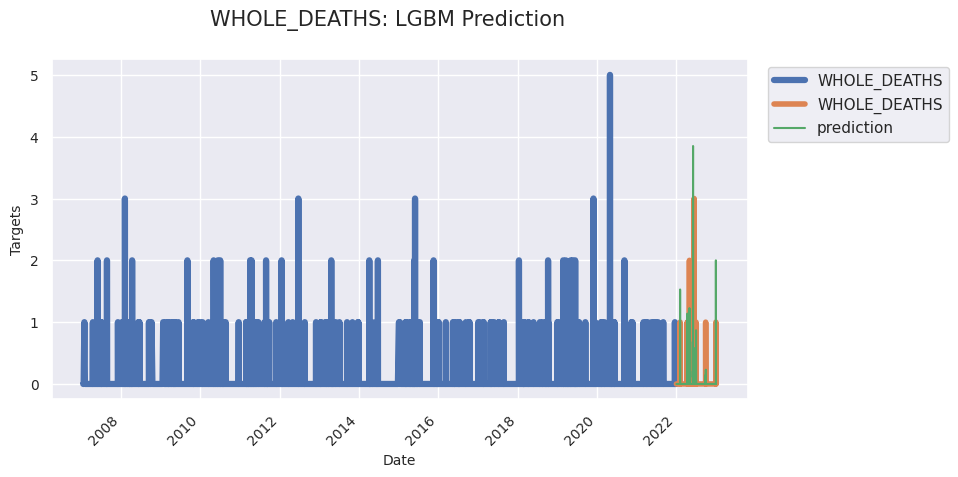

In [ ]:
fig, ax = plt.subplots(figsize=(8, 5))
y_train.plot(ax=ax, label='train',linewidth=4.5)
y_test.plot(ax=ax, label='test',linewidth=4)
test_df['WHOLE_DEATHS_predict_lgbm'].plot(ax=ax, label='prediction')
plt.suptitle('WHOLE_DEATHS: LGBM Prediction', fontsize=15)
plt.xlabel('Date',fontsize=10)
plt.ylabel('Targets', fontsize=10)
plt.yticks(rotation=0,fontsize=10)
plt.xticks(rotation=45, fontsize=10)
plt.legend(fontsize=10)
ax.legend(bbox_to_anchor=(1.3, 1.0))
plt.show()

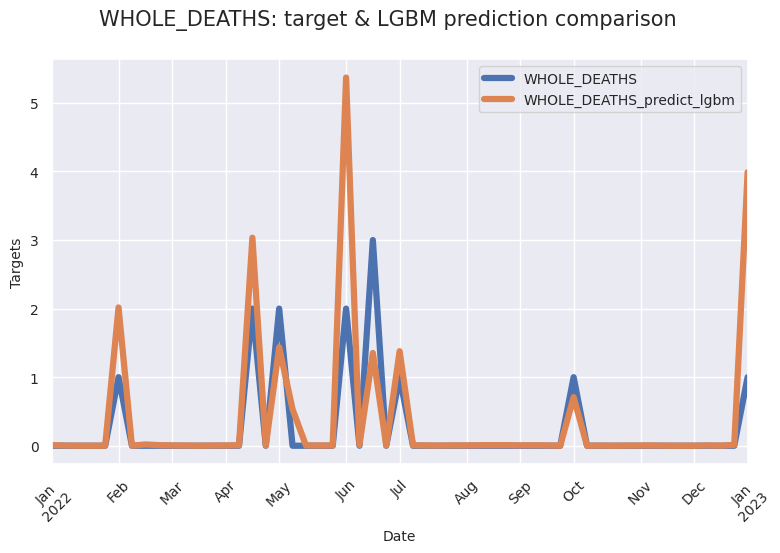

In [ ]:
# Plot results
test_df_agg = test_df.groupby(pd.Grouper(freq='W')).agg({
    'WHOLE_DEATHS': 'sum',
    'WHOLE_DEATHS_predict_lgbm': 'sum'})
plt.rcParams['figure.figsize'] = (8,5)
test_df_agg.plot(linewidth=4.5)
plt.suptitle('WHOLE_DEATHS: target & LGBM prediction comparison', fontsize=15)
plt.xlabel('Date',fontsize=10)
plt.ylabel('Targets', fontsize=10)
plt.yticks(rotation=0,fontsize=10)
plt.xticks(rotation=45, fontsize=10)
plt.legend(fontsize=10)
plt.show()

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002834 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5923
[LightGBM] [Info] Number of data points in the train set: 35727, number of used features: 48
[LightGBM] [Info] Start training from score -4.769929
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

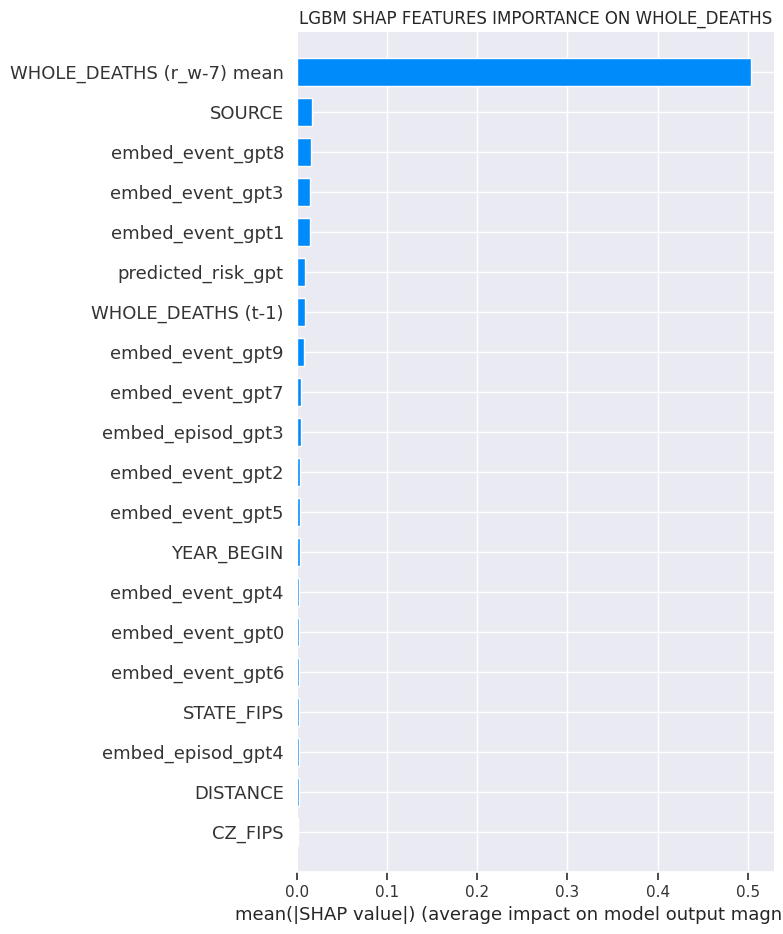

In [ ]:
# Global SHAP on LGBM
LGBM_ =  LGBMRegressor(
n_estimators= 736,
    learning_rate= 0.011061994491846881,
    max_depth= 4,
    num_leaves= 58,
    min_child_samples= 84,
    objective='poisson',
    random_state=0).fit(X_train_, y_train)
LGBM_explainer = shap.TreeExplainer(LGBM_)
LGBM_shap_values = LGBM_explainer.shap_values(X_test_)
plt.rcParams['figure.figsize'] = (5,5)
plt.title("LGBM SHAP FEATURES IMPORTANCE ON WHOLE_DEATHS")
shap.summary_plot(LGBM_shap_values, features=X_test_, feature_names=X_test_.columns,plot_type='bar')

### NN

#### Fine-tuning the model

In [ ]:
# fine-tuning
#def objective(trial):
#    params = {
#        'hidden_layer_sizes': (trial.suggest_int('n_neurons_1', 10, 500), trial.suggest_int('n_neurons_2', 10, 500), trial.suggest_int('n_neurons_3', 10, 500)),
#        'alpha': trial.suggest_loguniform('alpha', 1e-5, 1e2),
#        'learning_rate_init': trial.suggest_loguniform('learning_rate_init', 1e-4, 1e-2),
#        'max_iter': trial.suggest_int('max_iter', 10, 500),
#        'random_state': 0,
#        'activation':'relu'
#    }

#    mlp = MLPRegressor(**params)

#    tscv = TimeSeriesSplit(n_splits=5)
#    mpd_scores = []
#    train_exposure_ = pd.DataFrame(train_exposure, index=X_train_sc.index, columns=['exposure']) # Convert numpy array to DataFrame
#    X_train_sc_ = pd.concat([X_train_sc, train_exposure_], axis=1)


#    for train_index, val_index in tscv.split(X_train_sc_):
#        X_tr, X_val = X_train_sc_.iloc[train_index], X_train_sc_.iloc[val_index]
#        y_tr, y_val = y_train.iloc[train_index], y_train.iloc[val_index]

#        mlp.fit(X_tr, y_tr)
#        pred_val = mlp.predict(X_val)

#        pred_val = np.maximum(pred_val, 1e-12) # Ensure predictions are strictly positive

#        mpd_score = mean_poisson_deviance(y_val, pred_val)
#        mpd_scores.append(mpd_score)

#    return np.mean(mpd_scores)

#study = optuna.create_study(direction='minimize')
#study.optimize(objective, n_trials=10)

#best_params = study.best_params

[I 2024-05-16 09:12:33,942] A new study created in memory with name: no-name-b19d42dc-2ae4-4df4-b6ce-a6636b1e5d04
[I 2024-05-16 09:14:15,922] Trial 0 finished with value: 0.04915177839805955 and parameters: {'n_neurons_1': 121, 'n_neurons_2': 346, 'n_neurons_3': 91, 'alpha': 1.453569702508936e-05, 'learning_rate_init': 0.008072912239179424, 'max_iter': 328}. Best is trial 0 with value: 0.04915177839805955.
[I 2024-05-16 09:14:45,186] Trial 1 finished with value: 0.08640848382747171 and parameters: {'n_neurons_1': 146, 'n_neurons_2': 37, 'n_neurons_3': 455, 'alpha': 11.550870393852515, 'learning_rate_init': 0.0012220197003706141, 'max_iter': 336}. Best is trial 0 with value: 0.04915177839805955.
[I 2024-05-16 09:15:25,327] Trial 2 finished with value: 0.0842499953446842 and parameters: {'n_neurons_1': 308, 'n_neurons_2': 37, 'n_neurons_3': 134, 'alpha': 2.8380855138269507, 'learning_rate_init': 0.0006112729305835164, 'max_iter': 442}. Best is trial 0 with value: 0.04915177839805955.
[I 

In [ ]:
#best_params

{'n_neurons_1': 186,
 'n_neurons_2': 35,
 'n_neurons_3': 120,
 'alpha': 0.024764085769464414,
 'learning_rate_init': 0.00037278523702388044,
 'max_iter': 280}

#### Fit & Prediction

In [ ]:
train_exposure_ = pd.DataFrame(train_exposure, index=X_train_sc.index, columns=['exposure']) # Convert numpy array to DataFrame
test_exposure_ = pd.DataFrame(test_exposure, index=X_test_sc.index, columns=['exposure']) # Convert numpy array to DataFrame
X_train_sc_ = pd.concat([X_train_sc, train_exposure_], axis=1)
X_test_sc_ = pd.concat([X_test_sc, test_exposure_], axis=1)


nn_tuned =  MLPRegressor(
hidden_layer_sizes= (186,35,120),
activation= 'relu',
alpha= 0.024764085769464414,
learning_rate_init=0.00037278523702388044,
max_iter=280,
random_state=0)
tscv = TimeSeriesSplit(n_splits=5)
param_grid = {}
nn_model = GridSearchCV(nn_tuned,param_grid,cv=tscv)
nn_model.fit(X_train_sc_, y_train)
score_nn=[]
predictions_tr = np.maximum(nn_model.predict(X_train_sc_), 1e-12)
predictions_te = np.maximum(nn_model.predict(X_test_sc_),1e-12)
rmse_train = np.sqrt(mean_squared_error(y_train, predictions_tr))
rmse_test = np.sqrt(mean_squared_error(y_test, predictions_te))
mae_train = mean_absolute_error(y_train, predictions_tr)
mae_test = mean_absolute_error(y_test, predictions_te)
mpd_train = mean_poisson_deviance(y_train, predictions_tr)
mpd_test = mean_poisson_deviance(y_test, predictions_te)

score_dict = {
        'rmse_train': rmse_train,
        'rmse_test': rmse_test,
        'mae_train': mae_train,
        'mae_test': mae_test,
        'mpd_train': mpd_train,
        'mpd_test': mpd_test
    }

score_nn.append(score_dict)
score_nn = pd.DataFrame(score_nn, columns = ['rmse_train', 'rmse_test','mae_train','mae_test','mpd_train','mpd_test'])
predictions_tr_nn = pd.DataFrame(np.expm1(predictions_tr), columns = ['WHOLE_DEATHS_predict_nn'])
predictions_te_nn = pd.DataFrame(np.expm1(predictions_te), columns = ['WHOLE_DEATHS_predict_nn'])
train_df = pd.concat([train_df, predictions_tr_nn.set_index(train_df.index)], axis=1)
test_df = pd.concat([test_df, predictions_te_nn.set_index(test_df.index)], axis=1)


### Evaluation

In [ ]:
nn_results = {'model':['nn'],
               'rmse_train':score_nn['rmse_train'],
               'rmse_test': score_nn['rmse_test'],
              'mae_train': score_nn['mae_train'],
              'mae_test': score_nn['mae_test'],
              'mpd_train': score_nn['mpd_train'],
              'mpd_test': score_nn['mpd_test']
               }
score_nn = pd.DataFrame(nn_results,
                         columns=['model', 'rmse_train', 'rmse_test','mae_train','mae_test','mpd_train','mpd_test'])
score_nn

,model,rmse_train,rmse_test,mae_train,mae_test,mpd_train,mpd_test
0,nn,0.078869,0.091112,0.013937,0.015606,0.028492,0.03051


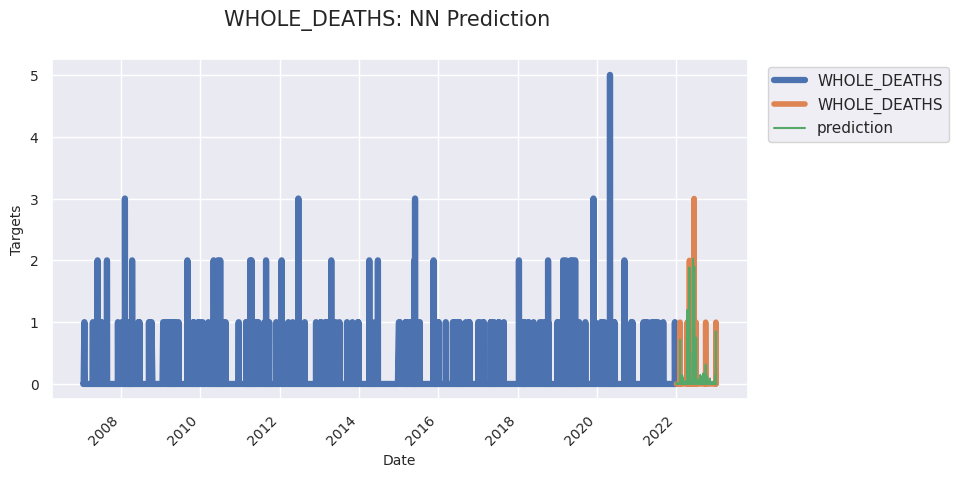

In [ ]:
fig, ax = plt.subplots(figsize=(8, 5))
y_train.plot(ax=ax, label='train',linewidth=4.5)
y_test.plot(ax=ax, label='test',linewidth=4)
test_df['WHOLE_DEATHS_predict_nn'].plot(ax=ax, label='prediction')
plt.suptitle('WHOLE_DEATHS: NN Prediction', fontsize=15)
plt.xlabel('Date',fontsize=10)
plt.ylabel('Targets', fontsize=10)
plt.yticks(rotation=0,fontsize=10)
plt.xticks(rotation=45, fontsize=10)
plt.legend(fontsize=10)
ax.legend(bbox_to_anchor=(1.3, 1.0))
plt.show()

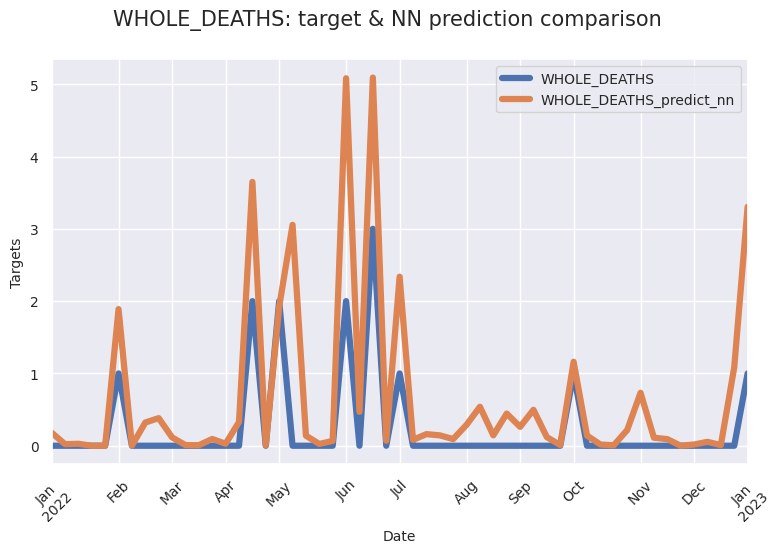

In [ ]:
test_df_agg = test_df.groupby(pd.Grouper(freq='W')).agg({
    'WHOLE_DEATHS': 'sum',
    'WHOLE_DEATHS_predict_nn': 'sum'})
plt.rcParams['figure.figsize'] = (8,5)
test_df_agg.plot(linewidth=4.5)
plt.suptitle('WHOLE_DEATHS: target & NN prediction comparison', fontsize=15)
plt.xlabel('Date',fontsize=10)
plt.ylabel('Targets', fontsize=10)
plt.yticks(rotation=0,fontsize=10)
plt.xticks(rotation=45, fontsize=10)
plt.legend(fontsize=10)
plt.show()

In [ ]:
# Global SHAP on NN
NN_ = MLPRegressor(
hidden_layer_sizes= (186,35,120),
activation= 'relu',
alpha= 0.024764085769464414,
learning_rate_init=0.00037278523702388044,
max_iter=280,
random_state=0).fit(X_train_sc_, y_train)

# Choose 100 random samples from train and test
train_sample_indices = np.random.choice(len(X_train_sc_), 100, replace=False)
test_sample_indices = np.random.choice(len(X_test_sc_), 100, replace=False)

NN_explainer = shap.KernelExplainer(NN_.predict, X_train_sc_.iloc[train_sample_indices])
NN_shap_values = NN_explainer.shap_values(X_test_sc_.iloc[test_sample_indices])
plt.rcParams['figure.figsize'] = (5,5)
plt.title("NN SHAP FEATURES IMPORTANCE ON WHOLE_DEATHS")
shap.summary_plot(NN_shap_values, features=X_test_sc_.iloc[test_sample_indices], feature_names=X_test_sc_.columns, plot_type='bar')

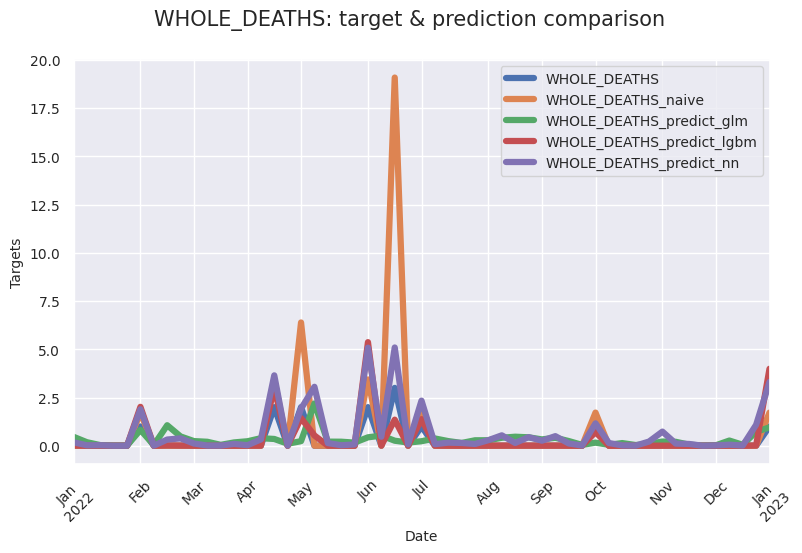

In [ ]:
# plot all models
test_df_agg = test_df.groupby(pd.Grouper(freq='W')).agg({
    'WHOLE_DEATHS': 'sum',
    'WHOLE_DEATHS_naive': 'sum',
    'WHOLE_DEATHS_predict_glm': 'sum',
    'WHOLE_DEATHS_predict_lgbm': 'sum',
    'WHOLE_DEATHS_predict_nn': 'sum'
    })
plt.rcParams['figure.figsize'] = (8,5)
test_df_agg.plot(linewidth=4.5)
plt.suptitle('WHOLE_DEATHS: target & prediction comparison', fontsize=15)
plt.xlabel('Date',fontsize=10)
plt.ylabel('Targets', fontsize=10)
plt.yticks(rotation=0,fontsize=10)
plt.xticks(rotation=45, fontsize=10)
plt.legend(fontsize=10)
plt.show()

In [ ]:
# total score
score = pd.concat([score_naive, score_glm, score_lgbm, score_nn])
score

,model,rmse_train,rmse_test,mae_train,mae_test,mpd_train,mpd_test
0,naive,0.146236,0.148992,0.016291,0.013742,N/A,N/A
0,glm,0.104784,0.105100,0.016771,0.015256,0.083448,0.073333
0,lgbm,0.060379,0.076444,0.007361,0.007149,0.011997,0.013035
0,nn,0.078869,0.091112,0.013937,0.015606,0.028492,0.03051


#### Plot score results

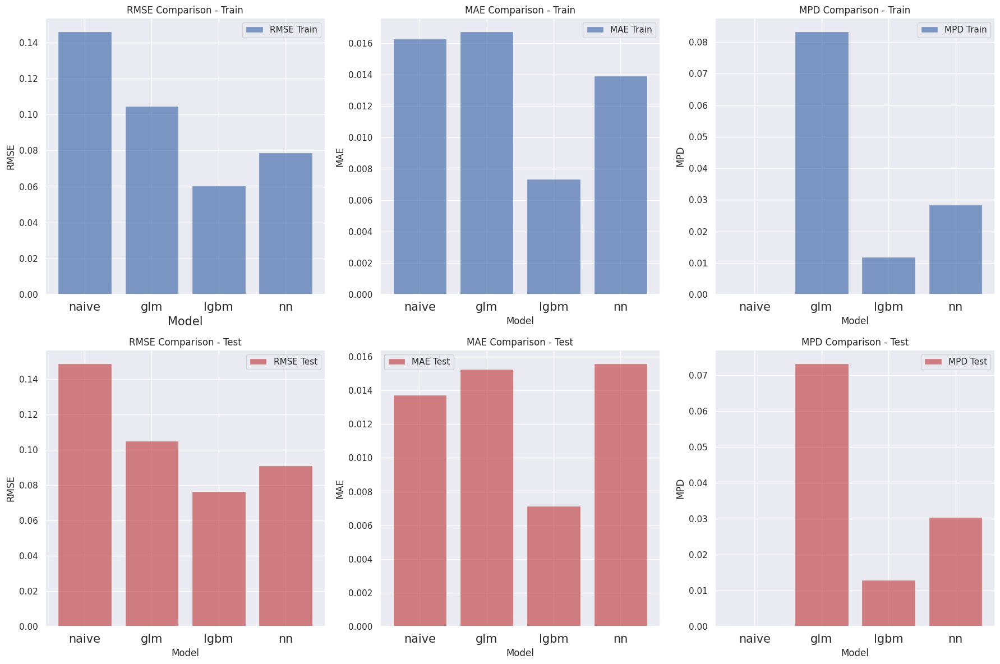

In [ ]:
# Reset the index of the DataFrame
score = score.reset_index(drop=True)

# Replace 'N/A' with 0 only for the 'naive' row
score.loc[score['model'] == 'naive', ['mpd_train', 'mpd_test']] = score.loc[score['model'] == 'naive', ['mpd_train', 'mpd_test']].replace('N/A', 0)

# Convert 'mpd_train' and 'mpd_test' to float type
score['mpd_train'] = score['mpd_train'].astype(float)
score['mpd_test'] = score['mpd_test'].astype(float)

# Plotting 6 charts with 3 per row
plt.figure(figsize=(18, 12))

# Plot RMSE comparison for Train and Test
plt.subplot(2, 3, 1)
plt.bar(score['model'], score['rmse_train'], color='b', alpha=0.7, label='RMSE Train')
plt.xlabel('Model',fontsize=15)
plt.ylabel('RMSE')
plt.xticks(fontsize=15)
plt.legend()
plt.title('RMSE Comparison - Train')

plt.subplot(2, 3, 4)
plt.bar(score['model'], score['rmse_test'], color='r', alpha=0.7, label='RMSE Test')
plt.xlabel('Model')
plt.ylabel('RMSE')
plt.xticks(fontsize=15)
plt.legend()
plt.title('RMSE Comparison - Test')

# Plot MAE comparison for Train and Test
plt.subplot(2, 3, 2)
plt.bar(score['model'], score['mae_train'], color='b', alpha=0.7, label='MAE Train')
plt.xlabel('Model')
plt.xticks(fontsize=15)
plt.ylabel('MAE')
plt.legend()
plt.title('MAE Comparison - Train')

plt.subplot(2, 3, 5)
plt.bar(score['model'], score['mae_test'], color='r', alpha=0.7, label='MAE Test')
plt.xlabel('Model')
plt.ylabel('MAE')
plt.xticks(fontsize=15)
plt.legend()
plt.title('MAE Comparison - Test')

# Plot MPD comparison for Train and Test
plt.subplot(2, 3, 3)
plt.bar(score['model'], score['mpd_train'], color='b', alpha=0.7, label='MPD Train')
plt.xlabel('Model')
plt.ylabel('MPD')
plt.xticks(fontsize=15)
plt.legend()
plt.title('MPD Comparison - Train')

plt.subplot(2, 3, 6)
plt.bar(score['model'], score['mpd_test'], color='r', alpha=0.7, label='MPD Test')
plt.xlabel('Model')
plt.ylabel('MPD')
plt.xticks(fontsize=15)
plt.legend()
plt.title('MPD Comparison - Test')

plt.tight_layout()
plt.show()